# Jupyter Notebook showing Numpy/Pandas use with In-situ Data
## AC9 Flow-thru data

Includes references to plotting using Matplotlib and related tools.

In [1]:
############################################
# INCLUDES
############################################
#libraries specific to this example
import numpy as np
import pandas as pd
import scipy as sp
from sklearn.linear_model import LinearRegression
import matplotlib as matplt
import matplotlib.pyplot as plt

#a set of libraries that perhaps should always be in Python source
import os 
import datetime
import sys
import gc
import getopt
import inspect
import math
import warnings

#a darn useful library for creating paths and one I recommend you load to your environment
from pathlib import Path

from pydoc import help                          # can type in the python console `help(name of function)` to get the documentation

#Import a custom library, in this case a fairly useful logging framework
debug_lib_location = Path("./")
sys.path.append(str(debug_lib_location))
import debug

warnings.filterwarnings('ignore')               # don't print out warnings


root_location=".." + os.sep + "data";

In [2]:
############################################
#JUPYTER NOTEBOOK OUTPUT CONTROL / FORMATTING
############################################
#set floating point to 4 places to things don't run loose
pd.options.display.float_format = '{:,.4f}'.format
np.set_printoptions(precision=4)

# Variable declaration

In [3]:
############################################
# GLOBAL VARIABLES
############################################
DEBUG = 1
DEBUG_DATA = 0

# CODE CONSTRAINTS
VERSION_NAME    = "AC9_Flow-thru"
VERSION_MAJOR   = 0
VERSION_MINOR   = 0
VERSION_RELEASE = 1

#used for values outside standard ASCII, just do it, you'll need it
ENCODING  ="utf-8"

############################################
# GLOBAL CONSTANTS
############################################


############################################
# APPLICATION VARIABLES
############################################

############################################
# GLOBAL CONFIGURATION
############################################
os.environ['PYTHONIOENCODING']=ENCODING


# Example of Defining a Function

In [4]:
def lib_diagnostics():
    debug.msg_debug("System version    #:{:>12}".format(sys.version))
    debug.msg_debug("Matplotlib version#:{:>12}".format(matplt.__version__))
    debug.msg_debug("Numpy version     #:{:>12}".format(np.__version__))
    debug.msg_debug("Pandas version    #:{:>12}".format(pd.__version__))
    debug.msg_debug("SciPy version     #:{:>12}".format(sp.__version__))

    return

# Library Invocation
### Note that it's also useful to use this code so that you carry around a list of version dependencies and know how you did something (version)

In [5]:
lib_diagnostics()

[2022-12-14 18:43:59 UTC]   DEBUG: System version    #:3.9.15 (main, Nov  4 2022, 16:13:54) 
[GCC 11.2.0] 
[2022-12-14 18:43:59 UTC]   DEBUG: Matplotlib version#:       3.5.3 
[2022-12-14 18:43:59 UTC]   DEBUG: Numpy version     #:      1.23.4 
[2022-12-14 18:43:59 UTC]   DEBUG: Pandas version    #:       1.5.1 
[2022-12-14 18:43:59 UTC]   DEBUG: SciPy version     #:       1.9.3 


# Data Read
### Using pandas read in a data file and establish a log for output.

In [6]:
filename=root_location + os.sep + "All_flo-thru.dat"

#there are an insane number of options, but generally if you have well structured data it's 'magic'
#Reference:http://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.read_csv.html#pandas.read_csv
#changed \t delimiter to ^ which made parsing the columns far easier

#straight from the WAP output with the delimiter modified
ac9flothru=pd.read_csv(filename, delimiter='^')



In [7]:
ac9flothru.head()

,Time(ms),Latitude,Longitude,Bottom_Depth(m),UTC/GMT_Time,a650__,a676__,a715__,c510__,c532__,...,c650__,c676__,c715__,a510__,a532__,a555__,c412__,c440__,c488__,Temperature(C)
0,"1,000.0000",30.3225,88.8931,0.0000,0.6713,0.6869,0.7193,0.5224,4.5003,4.1485,...,3.0008,2.8428,2.5976,1.3964,1.1843,1.0358,7.2849,6.0743,4.9176,14.4400
1,"2,000.0000",30.3225,88.8930,0.0000,0.6713,0.6901,0.7230,0.5237,4.5042,4.1503,...,3.0029,2.8432,2.5969,1.3960,1.1816,1.0312,7.2719,6.0647,4.9079,14.4400
2,"2,000.0000",30.3225,88.8930,0.0000,0.6713,0.6838,0.7157,0.5178,4.4947,4.1395,...,2.9922,2.8340,2.5881,1.3922,1.1809,1.0320,7.2677,6.0596,4.9026,14.4400
3,"2,000.0000",30.3225,88.8930,0.0000,0.6713,0.6864,0.7204,0.5217,4.4900,4.1368,...,2.9948,2.8400,2.5931,1.4021,1.1878,1.0360,7.2665,6.0578,4.8996,14.4400
4,"2,000.0000",30.3225,88.8930,0.0000,0.6713,0.6865,0.7197,0.5226,4.4867,4.1345,...,2.9924,2.8363,2.5932,1.3998,1.1818,1.0269,7.2650,6.0572,4.8975,14.4400


In [8]:
#show column header names.
print(ac9flothru.columns)

Index(['Time(ms)', 'Latitude', 'Longitude', 'Bottom_Depth(m)', 'UTC/GMT_Time',
       'a650__', 'a676__', 'a715__', 'c510__', 'c532__', 'c555__', 'a412__',
       'a440__', 'a488__', 'c650__', 'c676__', 'c715__', 'a510__', 'a532__',
       'a555__', 'c412__', 'c440__', 'c488__', 'Temperature(C)'],
      dtype='object')


# Plotting Routines and Examples
## Long running routines, be aware!

array([[<AxesSubplot:xlabel='a412__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a440__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a488__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a510__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a532__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a555__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a650__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a676__', ylabel='a412__'>,
        <AxesSubplot:xlabel='a715__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c412__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c440__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c488__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c510__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c532__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c555__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c650__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c676__', ylabel='a412__'>,
        <AxesSubplot:xlabel='c715__', ylabel='a4

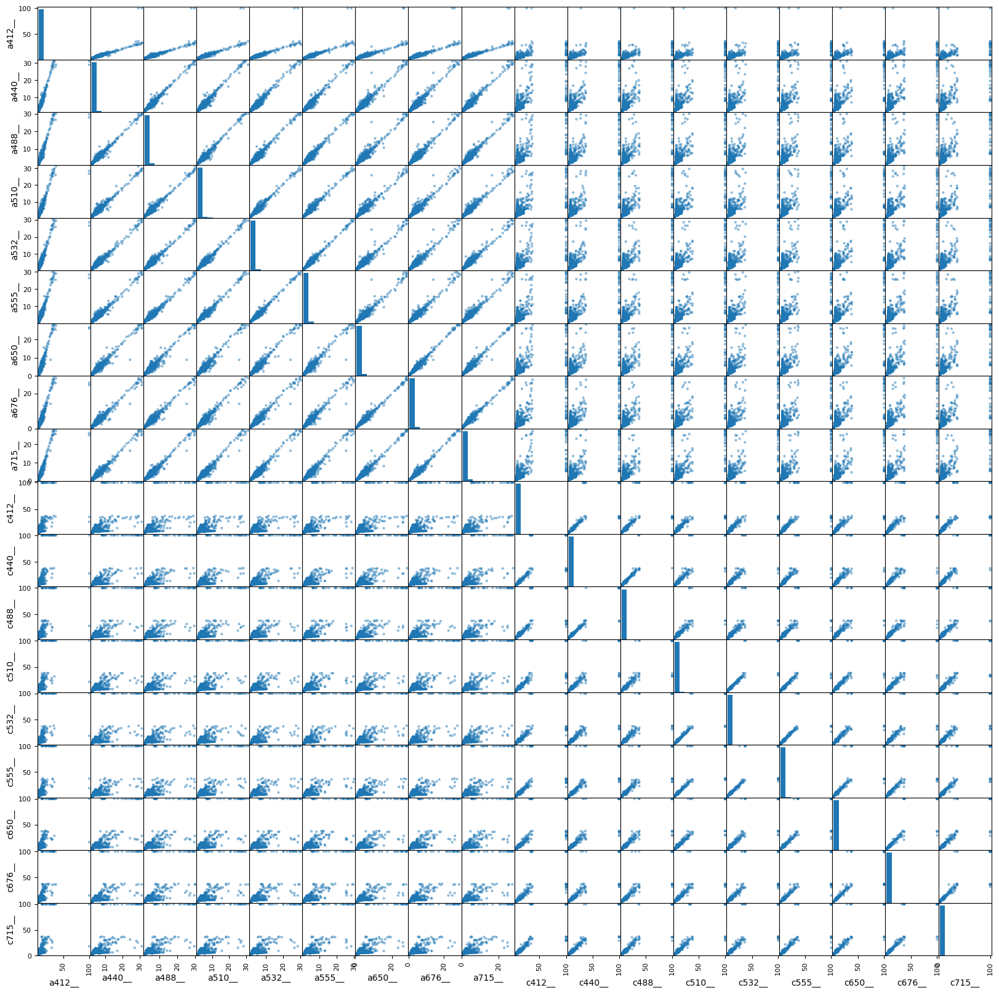

In [9]:
### now let's look at a lot of data quickly
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import scale
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from scipy import stats
from IPython.display import display, HTML

%matplotlib inline
a=[11,12,13,17,18,19,5,6,7]                 #Absorption wavelengths in order
c=[20,21,22,8,9,10,14,15,16]                #Beam Attenuation wavelengths in order
a_names=ac9flothru.columns[a].astype(str)   #put the list of names to a string, demonstration only

#uncomment to show the domain selected, helps with visualization
#ac9flothru.loc[:,ac9flothru.columns[a[:]]]

#plot a A * C matrix of histograms and a/c scatter matrix
pd.plotting.scatter_matrix(ac9flothru.loc[:,ac9flothru.columns[a[:]+c[:]]], figsize=(20,20))

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

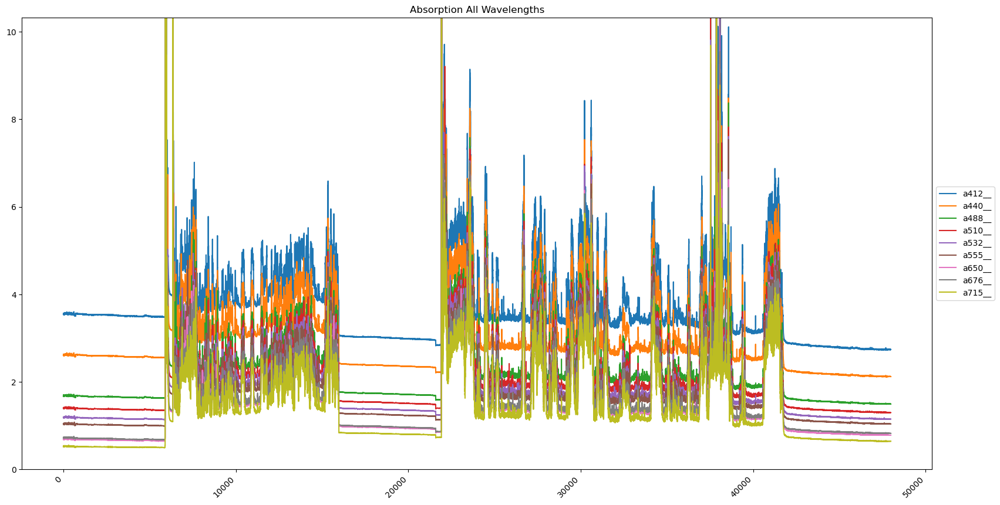

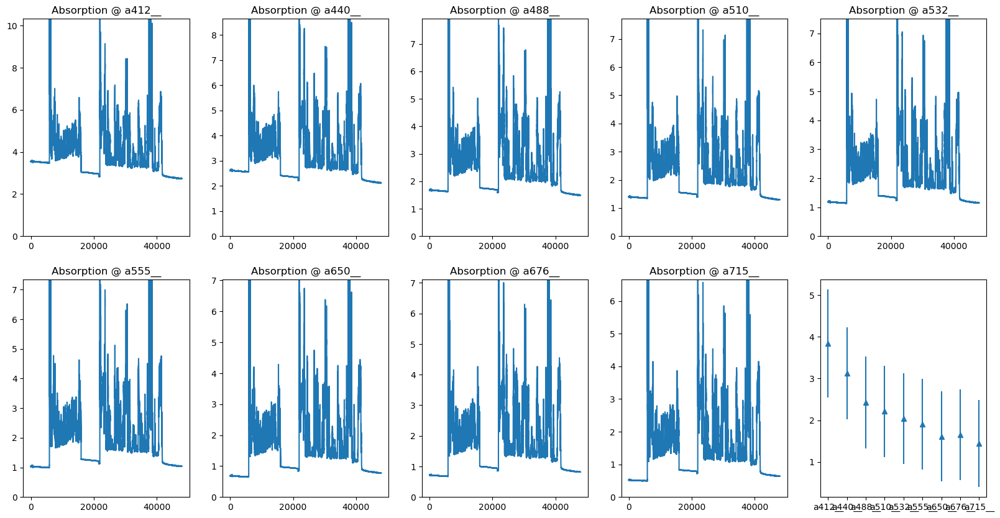

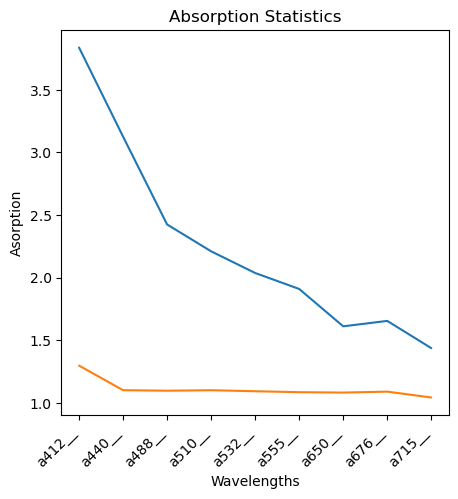

In [10]:
#Plot along wavelengths showing individual values, all values, and some basic statistics
#Consider this a very basic approach to plotting
#this keeps the plot within the context of this notebook, else the plot will appear in a new window
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
a=[11,12,13,17,18,19,5,6,7]             #Absorption wavelengths in order, WAP doesn't output in order
c=[20,21,22,8,9,10,14,15,16]            #Beam Attenuation wavelengths in order, WAP doesn't output in order

#examples of data plotting via another medium
#ac9flothru[ac9flothru.columns[11]].plot(kind='density')
#ac9flothru.plot(kind='scatter', x=ac9flothru.columns[0], y=ac9flothru.columns[a[0]])

#constants
PLT_MAX_ROW=2
PLT_MAX_COL=5
PLT_X_SIZE=20
PLT_Y_SIZE=10
PLT_LGD_X_OFFSET=1
PLT_LGD_Y_OFFSET=0.5
PLT_Y_SCALE_STDDEV=5
row_index=0
col_index=0
y_range_limit=20

#statistics
a_means=ac9flothru[ac9flothru.columns[a]].apply(np.mean)
a_std=ac9flothru[ac9flothru.columns[a]].apply(np.std)
a_mean_max=np.max(a_means)
a_std_max=np.max(a_std)
y_range_limit=a_mean_max + (a_std_max * PLT_Y_SCALE_STDDEV)

#initial fiture creating a 1 x 1 (default) # of plots in one page 20 x 10 in size (makes the plots larger)
fig, axes = plt.subplots(figsize=(PLT_X_SIZE, PLT_Y_SIZE))
ax=ac9flothru[ac9flothru.columns[a]].plot(ax=axes)
ax.legend(loc='center left', bbox_to_anchor=(PLT_LGD_X_OFFSET,PLT_LGD_Y_OFFSET))
labels=ax.get_xticklabels()
plt.setp(labels,rotation=45,horizontalalignment='right')
ax.set_ylim(bottom=0,top=y_range_limit)
ax.set_title(label="Absorption All Wavelengths")
ax.set_ylabel="Wavelength"
ax.set_xlabel="Time(s)"



#initial fiture creating a 2 x 5 # of plots in one page 20 x 10 in size (makes the plots larger)
fig, axes = plt.subplots(PLT_MAX_ROW, PLT_MAX_COL, figsize=(PLT_X_SIZE, PLT_Y_SIZE))
#iterate through the absorption array
for idx in a:
    if ( col_index == (PLT_MAX_COL ) ):
        row_index +=1
        col_index = 0
    ax=ac9flothru[ac9flothru.columns[idx]].plot(ax=axes[row_index,col_index])
    #legend offset removed, not enough room in the plot screen
    #ax.legend(loc='center left', bbox_to_anchor=(PLT_LGD_X_OFFSET,PLT_LGD_Y_OFFSET))
    a_specific_mean=a_means[ac9flothru.columns[idx]]
    a_specific_std=a_std[ac9flothru.columns[idx]]
    y_range_limit=a_specific_mean + (a_specific_std * PLT_Y_SCALE_STDDEV)
    ax.set_ylim(bottom=0,top=y_range_limit)
    ax.set_title(label="Absorption @ " + ac9flothru.columns[idx])
    ax.set_ylabel=""
    ax.set_xlabel="Time(s)"
    col_index+=1

#output the names of columns to a list; just an example
a_names=ac9flothru.columns.tolist()

#plot the means as the last index in the 2x5 array of plots
plt.set_title='Absorption Means'
plt.setp(labels,rotation=45,horizontalalignment='right')
ax=plt.errorbar(ac9flothru.columns[a],a_means, a_std, linestyle='None', marker='^' )

#new figure using seaborn api which "knows" your data based on titles / names
import seaborn as sns
fig, axes = plt.subplots(figsize=(5,5))
sns.set(style="darkgrid")
ax=sns.lineplot(data=a_means)
ax=sns.lineplot(data=a_std)
ax.set_title("Absorption Statistics")
ax.set_ylabel("Asorption")
ax.set_xlabel("Wavelengths")
labels=ax.get_xticklabels()
plt.setp(labels,rotation=45,horizontalalignment='right')

#you could do the same for Beam Attenuation

In [11]:
#using bokeh you can make the graph interactive and more "intelligent" to use for the end user
#basic pydata framework
import pandas as pd

#plotting libraries
import matplotlib.pyplot as plt
import seaborn as sns

#statistics and learning solutions
from sklearn.preprocessing import scale
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from scipy import stats
from IPython.display import display, HTML

#interactive plotting tools
from bokeh.plotting import figure, output_file, output_notebook, show
from bokeh.models import ColumnDataSource
from bokeh.models.tools import HoverTool


%matplotlib inline
output_notebook()

#data representation
a=[11,12,13,17,18,19,5,6,7]             #Absorption wavelengths in order, WAP doesn't output in order
c=[20,21,22,8,9,10,14,15,16]            #Beam Attenuation wavelengths in order, WAP doesn't output in order

#declare the source
source = ColumnDataSource(dict(
        xs=[ac9flothru['Time(ms)'].values],
        ys=[ac9flothru['a412__'].values],
    )
)

#map to bokeh compliant structure (data); nothing worked until I did this
ac9_source=ColumnDataSource(ac9flothru)

#when mousing over a value you'll get discrete results, you can add additional values to this
hover=HoverTool()
hover.tooltips=[
                ('Latitude', '@Latitude'),
                ('Longitude', '@Longitude'),
                ('Absorption 412 nm', '@a412__')
               ]

#show the actual plot; line example
#tools="wheel_zoom, box_zoom, box_select, lasso_select, help, reset"
#p=figure(title="Absorption", tools=tools, width=640, height=480)
p=figure(title="Absorption", width=640, height=480)
p.add_tools(hover)
p.line(x='Time(ms)', y='a412__', source=ac9_source, line_width=2)
p.title.text="a412 Line Chart Example"
show(p)

#show the actual plot; circle example
p=figure(title="Absorption", width=640, height=480)
p.circle(x='Time(ms)', y='a412__', source=ac9_source, size=2)
p.add_tools(hover)
p.title.text="a412 Circle Chart Example"
show(p)

Loading BokehJS ...